In [1]:
import numpy as np
import matplotlib.pyplot as plt
from GraphDomain import EncodePriority
import os

In [2]:
sc = "Datasets/IDPCDU_Edges/set1/"
TaskNames = os.listdir(sc)
TaskNames

['idpc_10x10x1000.idpc',
 'idpc_10x20x2713.idpc',
 'idpc_10x5x425.idpc',
 'idpc_15x15x3375.idpc',
 'idpc_15x30x12111.idpc',
 'idpc_15x7x1504.idpc',
 'idpc_20x10x2492.idpc',
 'idpc_20x20x8000.idpc',
 'idpc_20x40x26104.idpc',
 'idpc_25x12x4817.idpc',
 'idpc_25x25x15625.idpc',
 'idpc_25x50x57147.idpc',
 'idpc_30x15x10025.idpc',
 'idpc_30x30x27000.idpc',
 'idpc_30x60x89772.idpc',
 'idpc_35x17x13934.idpc',
 'idpc_35x35x42875.idpc',
 'idpc_35x70x123585.idpc',
 'idpc_40x20x18485.idpc',
 'idpc_40x40x64000.idpc',
 'idpc_40x80x130681.idpc',
 'idpc_45x22x43769.idpc',
 'idpc_45x45x91125.idpc',
 'idpc_45x90x322081.idpc']

In [3]:
def Load(index):
    path = sc + TaskNames[index]
    name = TaskNames[index].split('.')[0]
    task = EncodePriority(path=path, name=name)
    return task

In [4]:
mark = set()

def check_generated(individual, index, task:EncodePriority):
    individual = task.Decode(individual)
    individual = individual[:index]
    pre_size = len(mark)
    mark.add(tuple(individual))
    if(pre_size < len(mark)): return False
    
    return True

In [5]:
def GeneratorPopulaion(sizePop, task:EncodePriority):
    Populaion = []
    dims=task.NUM_DOMAIN
    for i in range(sizePop):
        pi = np.random.permutation(range(1, dims+1))
        f_pi, index = task.Cost(pi)
        while f_pi == task.best and check_generated(pi, index, task=task):
            pi = np.random.permutation(range(1, dims+1))
            f_pi, index = task.Cost(pi)
        
        Populaion.append((pi, f_pi))

    return Populaion

In [6]:
# def GeneratorPopulaion(sizePop, task:EncodePriority):
#     Populaion = []
#     dims=task.NUM_DOMAIN
#     for i in range(sizePop):
#         pi = np.random.permutation(range(1, dims+1))
#         f_pi = task.CostV1(pi)
#         Populaion.append((pi, f_pi))

#     return Populaion

In [7]:
def chooseParents(pop):
    n = len(pop)
    index1 = np.random.randint(n)
    index2 = np.random.randint(n)
    while index1 == index2:
        index2 = np.random.randint(n)
    
    index3 = np.random.randint(n)
    index4 = np.random.randint(n)
    while index3 == index4:
        index4 = np.random.randint(n)
    
    if pop[index1][1] < pop[index2][1]:
        p1 = pop[index1][0]
    else:
        p1 = pop[index2][0]
    
    if pop[index3][1] < pop[index4][1]:
        p2 = pop[index3][0]
    else:
        p2 = pop[index4][0]
    
    return p1, p2

In [8]:
def cross_pmx(p1, p2):
    n = len(p1)
    
    index1 = np.random.randint(1, n-1)
    index2 = np.random.randint(1, n-1)
    while index1 == index2:
       index2 = np.random.randint(1, n-1)
   
    if index1 > index2:
        temp = index1
        index1 = index2
        index2 = temp

    #print(index1, index2)

    o1 = np.array(p2)
    o2 = np.array(p1)

    pos1 = np.full(n+1, -1, dtype=int)
    pos2 = np.full(n+1, -1, dtype=int)
    for i in range(index1, index2+1):
        pos1[o1[i]] = i
        pos2[o2[i]] = i
        
    for i in range(n):
        if index1 <= i and i <= index2: continue

        id1 = i
        while True:
            if pos1[p1[id1]] == -1:
                o1[i] = p1[id1]
                break
            id1 = pos1[p1[id1]]
        
        id2 = i
        while True:
            if pos2[p2[id2]] == -1:
                o2[i] = p2[id2]
                break
            id2 = pos2[p2[id2]]
    
    return o1, o2

In [9]:
def paradox_mutation(indiv):
    n = len(indiv)
    index1 = 0
    index2 = np.random.randint(1, n-1)
    while index1 == index2:
       index2 = np.random.randint(1, n-1)
   
    if index1 > index2:
        temp = index1
        index1 = index2
        index2 = temp

    while index1 < index2:
        temp = indiv[index1]
        indiv[index1] = indiv[index2]
        indiv[index2] = temp
        index1 += 1
        index2 -= 1

    return indiv


In [10]:
def mutation_swap(individual):
    n = len(individual)
    res = np.array(individual)

    index1 = np.random.randint(n)
    index2 = np.random.randint(n)
    while index1 == index2:
        index2 = np.random.randint(n)

    temp = res[index1]
    res[index1] = res[index2]
    res[index2] = temp

    return res

In [11]:
import random
def selection(pre_pop, offs_pop, rate_sel = 0.1):  
    n = len(pre_pop)
    pre_pop.sort(key=lambda tup: tup[1])
    random.shuffle(offs_pop)
    # offs_pop.sort(key=lambda tup: tup[1])
    # pop = pre_pop[n_p:] + offs_pop[n_o:]
    # pop.sort(key=lambda tup: tup[1])
    next_pop = pre_pop[0:10] + offs_pop[0:n-10]
    next_pop.sort(key=lambda tup: tup[1])

    # pop = offs_pop + pre_pop
    # pop.sort(key=lambda tup: tup[1])
    # next_pop = pop[:n]

    return next_pop

In [12]:
from tqdm import tqdm

def GA(size_pop, num_gens, Pc, Pm, task:EncodePriority):
    population = GeneratorPopulaion(size_pop, task=task)
    population.sort(key=lambda tup: tup[1])
    print(population)
    logg = []
    logg.append([0, population[0]])

    for t in range(1, num_gens+1):
        offs_pop = []
        while len(offs_pop) < size_pop:
            p1, p2 = chooseParents(population)

            rand = np.random.random_sample()
            o1, o2 = [], []
            if rand <= Pc:
                o1, o2 = cross_pmx(p1, p2)
            else:
                o1 = paradox_mutation(p1)
                o2 = paradox_mutation(p2)
            if np.random.random_sample() < Pm:
                o1 = mutation_swap(o1)
                o2 = mutation_swap(o2)
            
            f_o1, id1 = task.Cost(o1)
            if not(check_generated(o1, id1, task)):
                offs_pop.append((o1, f_o1))

            f_o2, id2 = task.Cost(o2)
            if not(check_generated(o2, id2, task)):
                offs_pop.append((o2, f_o2))
        
        population = selection(population, offs_pop)
        print(population)
        logg.append([t, population[0]])
    
    return logg

In [13]:
# from tqdm import tqdm

# def GA(size_pop, num_gens, Pc, Pm, task:EncodePriority):
#     population = GeneratorPopulaion(size_pop, task=task)
#     logg = []

#     for t in range(num_gens):
#         offs_pop = []
#         while len(offs_pop) < size_pop:
#             p1, p2 = chooseParents(population)

#             rand = np.random.random_sample()
#             o1, o2 = [], []
#             if rand <= Pc:
#                 o1, o2 = cross_pmx(p1, p2)
#             else:
#                 o1 = paradox_mutation(p1)
#                 o2 = paradox_mutation(p2)
#             if np.random.random_sample() < Pm:
#                 o1 = paradox_mutation(o1)
#                 o2 = paradox_mutation(o2)
            
#             offs_pop.append((o1, task.CostV1(o1)))
#             offs_pop.append((o2, task.CostV1(o2)))
        
#         population = selection(population, offs_pop)
#         logg.append([t, population[0]])
    
#     return logg

In [14]:
def show(his, task):
    input = np.array(his, dtype=object)
    x = input[:, 0]
    y = np.array(input[:, 1])
    y = [i[1] for i in y]
    plt.plot(x, y)
    plt.title(task.NAME + ": best = {}".format(his[-1][1][1]))
    plt.show()

In [15]:
t = Load(10)

In [18]:
t.START_NODE

10

In [16]:
t.Cost([2,11,12,5,4,1,3,6,7,8,9,10,13,14,15,16,17,18,19,20])

(7.0, 5)

In [18]:
t.Cost([11,  1, 17, 16,  5,  3,  2, 18,  9,  8,  4, 13,  6, 14, 10, 12, 19,
        7, 15, 20])

(12.0, 2)

In [20]:
t.show_path([ 5,  8,  6,  9, 19,  1, 20, 12, 14, 18, 11,  3, 16, 10,  2, 17,  7,
          15, 13,  4])

[{16: [5, 7]}, {11: [10, 5]}]


([{16: [5, 7]}, {11: [10, 5]}], 12.0)

In [21]:
np.random.seed(2)
random.seed(2)
mark = set()
history = GA(70, 2, 0.7, 0.1, t)

[(array([25,  7,  8,  9, 19,  5,  1,  6, 10, 15, 12, 11, 18, 17, 24, 21,  3,
       22, 23, 20, 16, 13, 14,  4,  2]), 27.0), (array([25, 16, 24, 15,  2, 22, 17, 21, 11, 18, 14,  4, 20,  6,  3, 23,  1,
        7, 12,  8,  9, 13, 19,  5, 10]), 27.0), (array([25, 21,  6,  8, 22, 23, 11,  1, 20,  5,  4,  9, 19,  3, 13, 15, 16,
       12, 17, 24, 14, 18,  2, 10,  7]), 27.0), (array([ 4, 22, 10, 15, 13,  7, 21,  2,  3, 17, 25, 19,  9,  1, 20, 11,  5,
       24, 23, 12,  8, 14, 16, 18,  6]), 32.0), (array([ 7, 18, 15, 20,  4,  5,  9, 14,  1,  3, 24, 19, 21, 11, 13, 10, 17,
        8,  6, 22,  2, 25, 16, 23, 12]), 32.0), (array([14, 16, 12,  6,  1,  5, 20, 11,  4, 24, 25,  8,  7, 22, 23, 17, 15,
        3, 18,  2, 13, 21, 19,  9, 10]), 32.0), (array([14, 22,  7, 23,  5,  4,  2, 20, 19,  3, 11,  6, 17, 25,  1, 16, 24,
       21, 12, 10, 15, 13,  9, 18,  8]), 33.0), (array([14, 22, 13, 16,  4, 25,  8, 23,  3, 19, 10, 20, 17, 12, 24,  2,  6,
       21,  9, 18, 15, 11,  7,  1,  5]), 33.0), (array(

In [19]:
history

[[0,
  (array([15,  6, 23,  1, 13, 24,  9,  3,  7, 19,  4, 11, 22, 17, 12, 18, 10,
          16, 20,  8, 25, 21,  5, 14,  2]),
   27.0)],
 [1,
  (array([15,  6, 23,  1, 13, 24,  9,  3,  7, 19,  4, 11, 22, 17, 12, 18, 10,
          16, 20,  8, 25, 21,  5, 14,  2]),
   27.0)],
 [2,
  (array([15,  6, 23,  1, 13, 24,  9,  3,  7, 19,  4, 11, 22, 17, 12, 18, 10,
          16, 20,  8, 25, 21,  5, 14,  2]),
   27.0)],
 [3,
  (array([15,  6, 23,  1, 13, 24,  9,  3,  7, 19,  4, 11, 22, 17, 12, 18, 10,
          16, 20,  8, 25, 21,  5, 14,  2]),
   27.0)],
 [4,
  (array([15,  6, 23,  1, 13, 24,  9,  3,  7, 19,  4, 11, 22, 17, 12, 18, 10,
          16, 20,  8, 25, 21,  5, 14,  2]),
   27.0)],
 [5,
  (array([15,  6, 23,  1, 13, 24,  9,  3,  7, 19,  4, 11, 22, 17, 12, 18, 10,
          16, 20,  8, 25, 21,  5, 14,  2]),
   27.0)],
 [6,
  (array([15,  6, 23,  1, 13, 24,  9,  3,  7, 19,  4, 11, 22, 17, 12, 18, 10,
          16, 20,  8, 25, 21,  5, 14,  2]),
   27.0)],
 [7,
  (array([15,  6, 23,  1, 13,

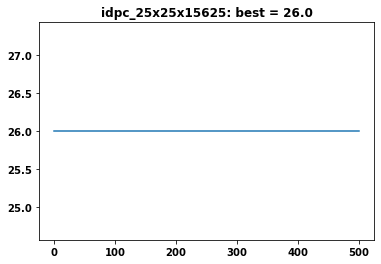

In [17]:
show(history, t)

In [12]:
avg = {}
best = {}
for i in tqdm(range(10, 24)):
    sum = 0
    b = np.inf
    for j in range(30):
        np.random.seed(j)
        task = Load(i)
        history = GA(100, 500, 0.75, 0.1, task)
        sum += history[-1][1][1]
        b = min(b, history[-1][1][1])

    avg[TaskNames[i]] = sum/30
    best[TaskNames[i]] = b


  0%|          | 0/14 [00:06<?, ?it/s]


KeyboardInterrupt: 

In [ ]:
avg

{'idpc_25x25x15625.idpc': 26.0,
 'idpc_25x50x57147.idpc': 26.0,
 'idpc_30x15x10025.idpc': 33.0}

In [ ]:
best

{'idpc_25x25x15625.idpc': 26.0,
 'idpc_25x50x57147.idpc': 26.0,
 'idpc_30x15x10025.idpc': 33.0}